<a href="https://colab.research.google.com/github/DrYGuo/Defect-detection-in-atomic-resolution-image-via-unsupervised-learning-with-translational-invariance/blob/main/OneClass_SVM_for_defect_detection_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

The code is to process the STEM data of 2H MoWTe2.

Mount the shared drives 'TMD_NIST'

> Then, run the following things



# 1.Install dependencies

In [1]:
import matplotlib.pyplot as plt
import numpy as np
# import dm3_lib
import skimage.feature
from matplotlib.patches import Circle
import matplotlib.colors
import scipy.ndimage
#from numba import jit
from collections import namedtuple
!pip install scikit-image
import json

# 2.Load the data from Google drive

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
! ls /content/drive/Shared\ drives/

TMD_NIST


In [4]:
path='/content/drive/Shared drives/TMD_NIST/data/2H MoWTe2 x=0.09/2H MoWTe2 large field of view acquisition.ndata1'

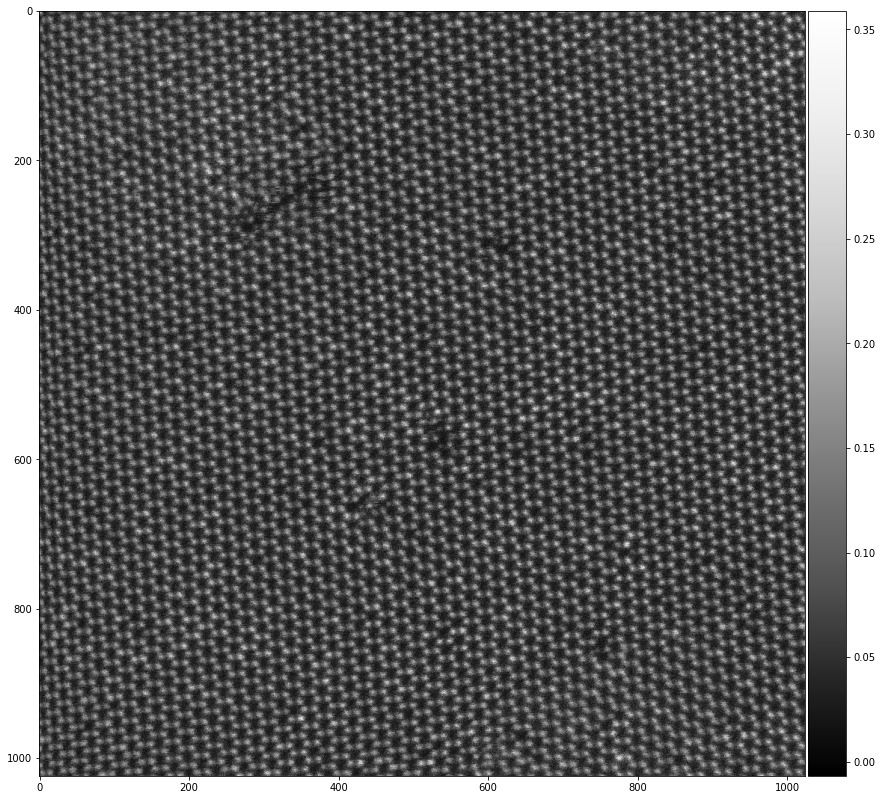

In [5]:
data_zipped=np.load(path)
#data=data_zipped['data'][:,30:] # remove the left margin with flyback error 
data=data_zipped['data']
#plot the image

from mpl_toolkits.axes_grid1 import make_axes_locatable

fig,ax = plt.subplots(1,figsize=(12,12))

divider = make_axes_locatable(ax)
cax = divider.append_axes('right', size='5%', pad=0.05)

im=ax.imshow(data,cmap='Greys_r')
plt.tight_layout()

fig.colorbar(im, cax=cax, orientation='vertical')
plt.show()




## Metadata

In [6]:
# FFT 
#from scipy import fftpack
# im_fft = fftpack.fft2(data)
# im_fft_shift=fftpack.fftshift(im_fft)

# # Show the results

# def plot_spectrum(im_fft):
#     from matplotlib.colors import LogNorm
#     # A logarithmic colormap
#     plt.imshow(np.abs(im_fft), norm=LogNorm(vmin=1))
#     plt.colorbar()

# plt.figure()
# plot_spectrum(im_fft_shift)
# plt.title('Fourier transform')

In [7]:
print(data_zipped.files)

['metadata.json', 'data']


Grab the "scale" from "spatial_calibrations" in the metadata

In [8]:
metadata=data_zipped['metadata.json']
print(metadata)
scalebar=json.loads(metadata)['spatial_calibrations'][0]['scale']
print(scalebar)

b'{"version": 1, "reader_version": 1, "spatial_calibrations": [{"offset": -8.0, "scale": 0.015625, "units": "nm"}, {"offset": -8.0, "scale": 0.015625, "units": "nm"}], "intensity_calibration": {"offset": 0.0, "scale": 1.0, "units": ""}, "collection_dimension_count": 0, "datum_dimension_count": 2, "metadata": {"hardware_source": {"autostem": {"high_tension_v": 100000.0, "defocus_m": 2.4302702323399067e-09, "ImageScanned:C1 ConstW": 0.374, "ImageScanned:C10": 2.43027e-09, "ImageScanned:C12.a": 1.11285e-08, "ImageScanned:C12.b": -8.39261e-09, "ImageScanned:C21.a": -1.14478e-07, "ImageScanned:C21.b": -3.04613e-08, "ImageScanned:C23.a": 2.4295e-09, "ImageScanned:C23.b": -1.73943e-08, "ImageScanned:C30": 3.8013e-06, "ImageScanned:C32.a": 5.59028e-06, "ImageScanned:C32.b": -7.59442e-06, "ImageScanned:C34.a": -2.55065e-07, "ImageScanned:C34.b": 3.01597e-06, "ImageScanned:C41.a": 0.000300423, "ImageScanned:C41.b": 7.99391e-05, "ImageScanned:C43.a": -9.56357e-06, "ImageScanned:C43.b": 6.84714e-0

In [9]:
information=json.loads(metadata)["metadata"]
print(information)

{'hardware_source': {'autostem': {'high_tension_v': 100000.0, 'defocus_m': 2.4302702323399067e-09, 'ImageScanned:C1 ConstW': 0.374, 'ImageScanned:C10': 2.43027e-09, 'ImageScanned:C12.a': 1.11285e-08, 'ImageScanned:C12.b': -8.39261e-09, 'ImageScanned:C21.a': -1.14478e-07, 'ImageScanned:C21.b': -3.04613e-08, 'ImageScanned:C23.a': 2.4295e-09, 'ImageScanned:C23.b': -1.73943e-08, 'ImageScanned:C30': 3.8013e-06, 'ImageScanned:C32.a': 5.59028e-06, 'ImageScanned:C32.b': -7.59442e-06, 'ImageScanned:C34.a': -2.55065e-07, 'ImageScanned:C34.b': 3.01597e-06, 'ImageScanned:C41.a': 0.000300423, 'ImageScanned:C41.b': 7.99391e-05, 'ImageScanned:C43.a': -9.56357e-06, 'ImageScanned:C43.b': 6.84714e-05, 'ImageScanned:C45.a': -0.000112058, 'ImageScanned:C45.b': 6.08676e-05, 'ImageScanned:C50': 0.00159257, 'ImageScanned:C52.a': -0.00765066, 'ImageScanned:C52.b': 0.00922618, 'ImageScanned:C54.a': -0.00334345, 'ImageScanned:C54.b': 0.00236297, 'ImageScanned:C56.a': -0.00116595, 'ImageScanned:C56.b': 0.0010319

In [10]:
metadata.decode()

'{"version": 1, "reader_version": 1, "spatial_calibrations": [{"offset": -8.0, "scale": 0.015625, "units": "nm"}, {"offset": -8.0, "scale": 0.015625, "units": "nm"}], "intensity_calibration": {"offset": 0.0, "scale": 1.0, "units": ""}, "collection_dimension_count": 0, "datum_dimension_count": 2, "metadata": {"hardware_source": {"autostem": {"high_tension_v": 100000.0, "defocus_m": 2.4302702323399067e-09, "ImageScanned:C1 ConstW": 0.374, "ImageScanned:C10": 2.43027e-09, "ImageScanned:C12.a": 1.11285e-08, "ImageScanned:C12.b": -8.39261e-09, "ImageScanned:C21.a": -1.14478e-07, "ImageScanned:C21.b": -3.04613e-08, "ImageScanned:C23.a": 2.4295e-09, "ImageScanned:C23.b": -1.73943e-08, "ImageScanned:C30": 3.8013e-06, "ImageScanned:C32.a": 5.59028e-06, "ImageScanned:C32.b": -7.59442e-06, "ImageScanned:C34.a": -2.55065e-07, "ImageScanned:C34.b": 3.01597e-06, "ImageScanned:C41.a": 0.000300423, "ImageScanned:C41.b": 7.99391e-05, "ImageScanned:C43.a": -9.56357e-06, "ImageScanned:C43.b": 6.84714e-05

##**Add scale bar to the image**

In [11]:
ADFscale=scalebar

In [12]:
sb = 2# nm
scalebar = sb / ADFscale

In [13]:
import matplotlib.gridspec as gridspec
import matplotlib.patches as patches

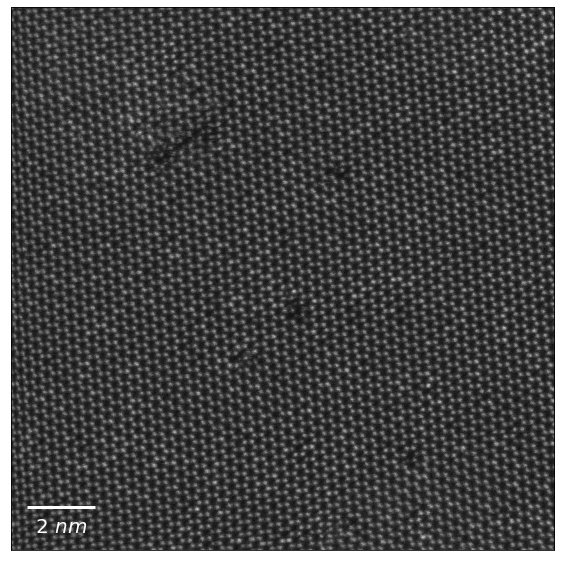

In [14]:
# %matplotlib inline
fsx,fsy = 10,10

f,a = plt.subplots(figsize=(fsx,fsy))
gs = gridspec.GridSpec(1, 1, hspace = 0.1, wspace= 0.1)
ax1 = plt.subplot(gs[0, 0])

ax1.imshow(data, cmap = 'gray')

scalebar1 = patches.Rectangle((0.03*data.shape[1],0.92*data.shape[0]), scalebar, 0.5, linewidth=3,edgecolor='white', facecolor = 'white')
ax1.add_patch(scalebar1);
sbpos = scalebar1.get_bbox().get_points()
sbcenter = (sbpos[1][0]-sbpos[0][0])/2 + sbpos[0][0]  # for whatever reason it doesn't come out quite at the center, hence the 2.3 factor instead of just 2
ax1.text(sbcenter, 1.05*sbpos[1][1], '${}$ $nm$'.format(sb), fontsize = 20, weight = 'bold', color = 'white', ha = 'center')
plt.setp([ax1], xticks = [], yticks = []);
plt.savefig('MoWTe2',dpi=300,pad_inches=0.0)

# Smooth and normalize the image

In [15]:
plt.set_cmap('Greys_r')

<Figure size 432x288 with 0 Axes>

In [16]:
import scipy


YG_data=scipy.ndimage.gaussian_filter(data,sigma=2)

def normalize_image(image):
    """
    Normalizes the provided image from 0 to 1

    Parameters
    ----------
    image : np.array object
        Image to be normalized

    Returns
    -------
    image : np.array object
        Image normalized from 0 to 1
    """
    return (image - np.amin(image)) / (np.amax(image) - np.amin(image))

YG_data_norm=normalize_image(YG_data)
# plt.imshow(YG_data)
# plt.colorbar()


In [17]:
data_inverted=np.ones((data.shape[0],data.shape[1]))-YG_data_norm

(0.0, 1.0)

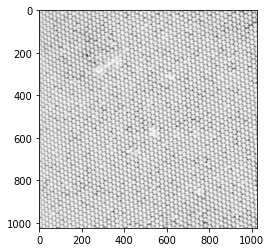

In [18]:
plt.imshow(data_inverted)
data_inverted.min(),data_inverted.max()

# Hole finder
xy are the coordinates of the holes
xy2 are the coordinates of the atoms

(2461, 2)


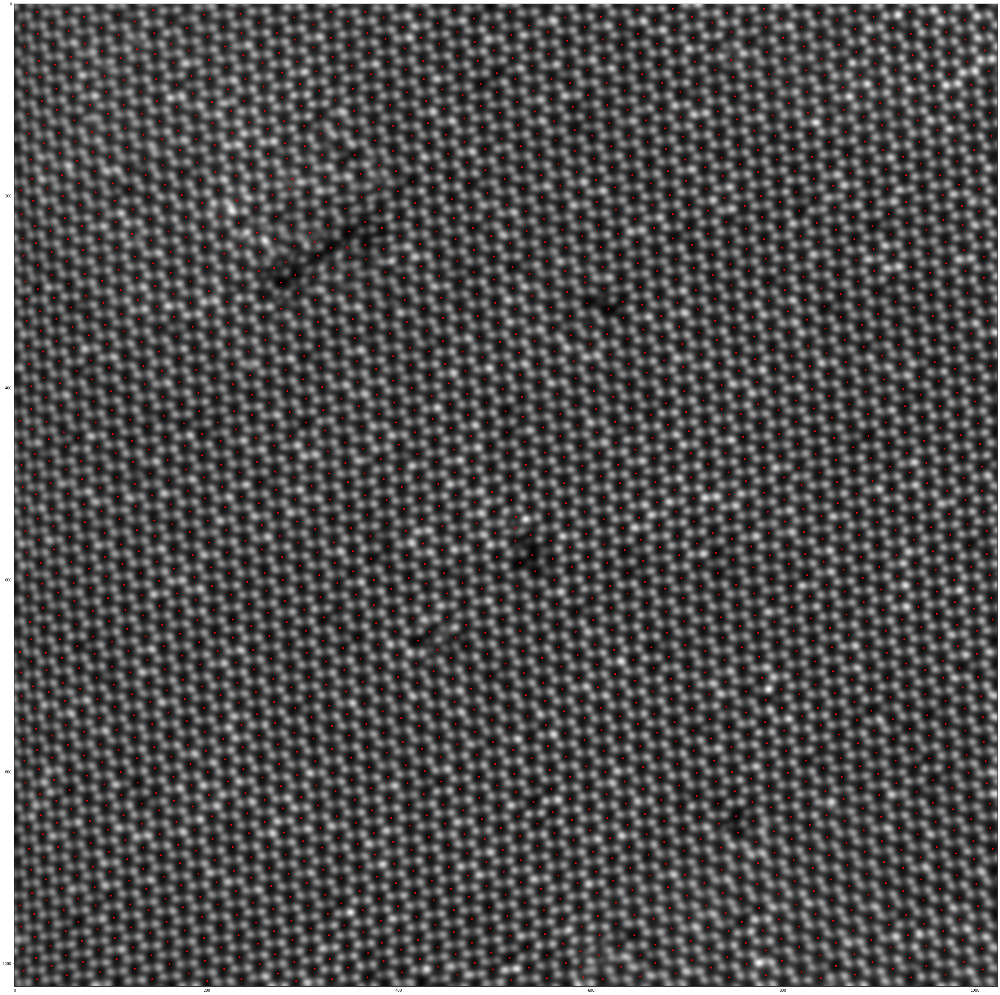

In [19]:
from skimage.feature import peak_local_max
xy= peak_local_max(data_inverted, min_distance=5,threshold_abs=0.00)
array1,array2=np.hsplit(xy,2)
plt.figure(figsize=(50,50))
plt.scatter(array2,array1,s=15,c='red')
plt.imshow(YG_data_norm,cmap='gray')
print(xy.shape)

(4962, 2)


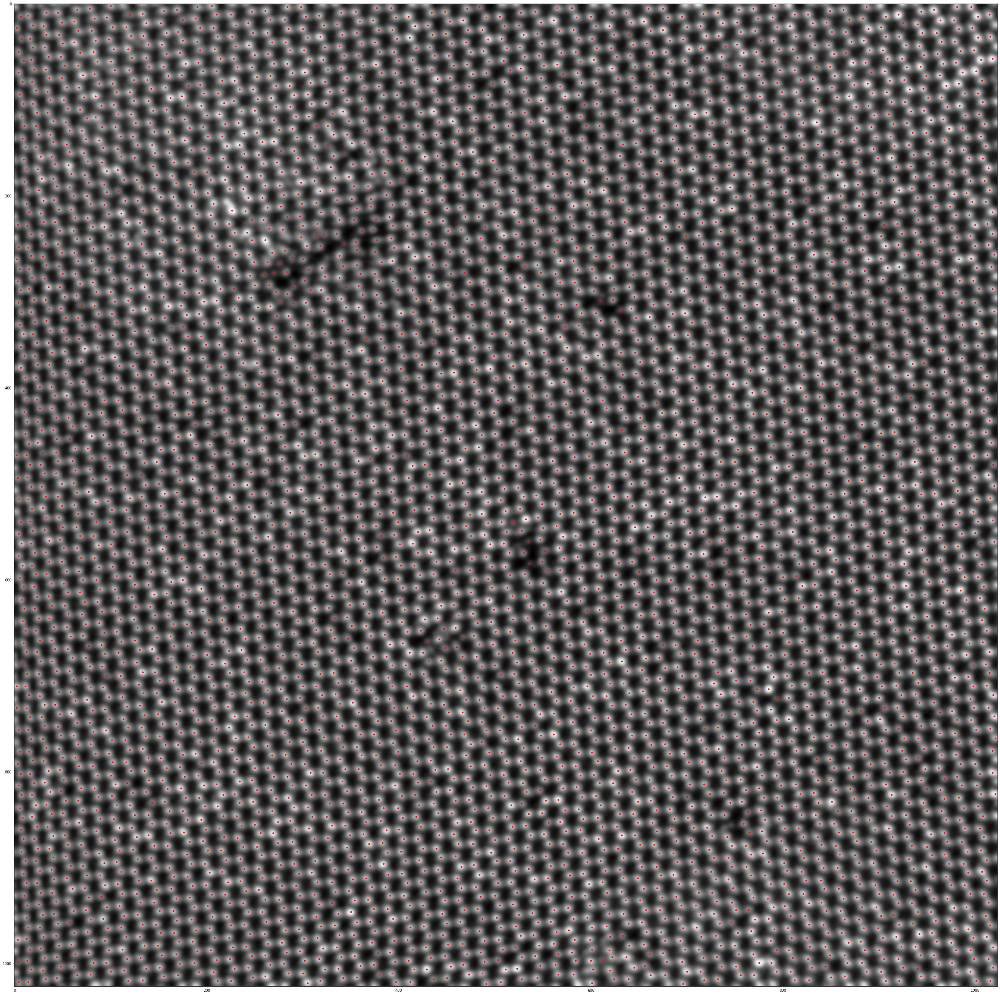

In [20]:
import scipy

img_data=data

YG_data=scipy.ndimage.gaussian_filter(img_data,sigma=2)

def normalize_image(image):
    """
    Normalizes the provided image from 0 to 1

    Parameters
    ----------
    image : np.array object
        Image to be normalized

    Returns
    -------
    image : np.array object
        Image normalized from 0 to 1
    """
    return (image - np.amin(image)) / (np.amax(image) - np.amin(image))

YG_data_norm=normalize_image(YG_data)
# plt.imshow(YG_data)
# plt.colorbar()


data2 = YG_data_norm

from skimage.feature import peak_local_max
xy2= peak_local_max(data2, min_distance=2,threshold_abs=0.00)

plt.figure(figsize=(50,50))
plt.scatter(xy2[:,1],xy2[:,0],s=15,c='red')
plt.imshow(YG_data_norm)
#plt.colorbar()

print(xy2.shape)

In [21]:
# #fig,ax=plt.figure(figsize=(20,20))

# fig, ax = plt.subplots(1, 1, figsize=(30,30))

# ax.imshow(data2)
# ax.scatter(xy2[:,1],xy2[:,0],s=10,c='r')
# #ax.scatter(xy2_refined[:,1],xy2_refined[:,0],s=1,c='b')
# ax.set_title('before position refienment')

# Refine atom positions 

# Refine the hole coordinates

In [22]:
# What should be the optimal size of a mask?

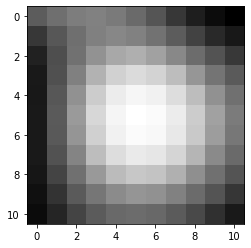

In [23]:
plt.imshow(data2[xy2[100,0]-5:xy2[100,0]+6,xy2[100,1]-5:xy2[100,1]+6])

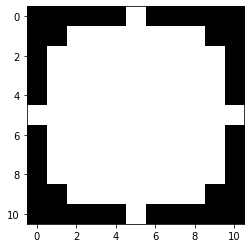

In [24]:
import math

wind_size2=11

mask_circle=np.zeros((wind_size2,wind_size2))

h,w=mask_circle.shape
y_center=math.floor(h/2)
x_center=math.floor(w/2)
mask=np.zeros((h,w))

r_crit=math.floor(h/2)


for i in np.arange(w):
   for j in np.arange(h):
     if (i-x_center)**2 + (j-y_center)**2 <=r_crit**2:
        mask[i,j]=1

plt.imshow(mask)
#plt.colorbar()


In [25]:
math.floor(wind_size2/2)

5

In [26]:
mask.shape

(11, 11)

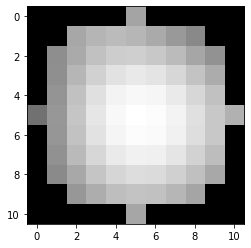

In [27]:
plt.imshow(data2[xy2[100,0]-math.floor(wind_size2/2):xy2[100,0]+math.floor(wind_size2/2)+1,xy2[100,1]-math.floor(wind_size2/2):xy2[100,1]+math.floor(wind_size2/2)+1]*mask)

shift mask around each original position and maximize the total intensity within the masked area

In [28]:
xy2.dtype


dtype('int64')

In [29]:
xy2_refined=xy2.copy()
print(id(xy2))
print(id(xy2_refined))
print(xy2_refined.dtype)

139989016841232
139988840935056
int64


In [30]:
xy2_refined=xy2.copy()

for jj, x_y in enumerate(xy2):
  x=x_y[0]
  y=x_y[1]
  if x-math.floor(wind_size2/2)>=0 and x+math.floor(wind_size2/2)+1<=data_inverted.shape[0]-1 and y-math.floor(wind_size2/2)>=0 and y+math.floor(wind_size2/2)+1<=data_inverted.shape[1]-1:
    data2_area_max=np.sum(np.sum(data2[x-math.floor(wind_size2/2):x+math.floor(wind_size2/2)+1,y-math.floor(wind_size2/2):y+math.floor(wind_size2/2)+1]*mask))
    data2_area_max_init=data2_area_max

    for i in np.arange(-3,3,1):
      for j in np.arange(-3,3,1):
         if x-math.floor(wind_size2/2)+i>=0 and x+math.floor(wind_size2/2)+1+i<=data_inverted.shape[0]-1 and y-math.floor(wind_size2/2)+j>=0 and y+math.floor(wind_size2/2)+1+j<=data_inverted.shape[1]-1: #if the area is not beyond the edge
            masked_area=data2[x-math.floor(wind_size2/2)+i:x+math.floor(wind_size2/2)+1+i,y-math.floor(wind_size2/2)+j:y+math.floor(wind_size2/2)+1+j]*mask
            if np.sum(np.sum(masked_area))>data2_area_max:
              data2_area_max=np.sum(np.sum(masked_area))
              xy2_refined[jj,0]=int(x+i)
              xy2_refined[jj,1]=int(y+j)
    if data2_area_max!=data2_area_max_init: # if the refined coordinates are different from the original xy2
      print(jj,'Oops')
      print(jj,data2_area_max,xy2_refined[jj,0]-xy2[jj,0],xy2_refined[jj,1]-xy2[jj,1])


Streaming output truncated to the last 5000 lines.
87 Oops
87 33.65990595519543 -1 0
91 Oops
91 31.14733238518238 1 -3
94 Oops
94 34.98273687064648 1 0
95 Oops
95 36.75711578130722 1 0
96 Oops
96 34.5960148870945 0 -1
98 Oops
98 36.03492617607117 -2 -1
100 Oops
100 32.27209581434727 0 1
101 Oops
101 38.008896976709366 1 0
102 Oops
102 40.57234889268875 1 0
103 Oops
103 40.02163764834404 -1 0
104 Oops
104 46.3500397503376 0 -1
105 Oops
105 59.43819695711136 0 1
106 Oops
106 33.899303525686264 1 0
107 Oops
107 35.070780634880066 0 1
109 Oops
109 41.39059895277023 1 0
110 Oops
110 37.44525325298309 -2 -1
111 Oops
111 33.64564995467663 -1 0
112 Oops
112 33.87537056207657 -1 -1
114 Oops
114 41.16132226586342 1 0
115 Oops
115 33.14832280576229 -3 -1
117 Oops
117 34.718824073672295 0 1
119 Oops
119 23.03732131421566 -3 2
120 Oops
120 25.59091503918171 1 0
122 Oops
122 38.05548442900181 1 0
123 Oops
123 35.34176616370678 -1 0
124 Oops
124 41.401886731386185 1 0
125 Oops
125 35.865099892020226 

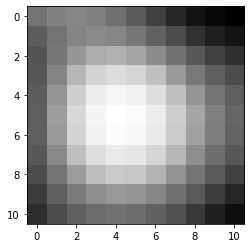

In [31]:
plt.imshow(data2[xy2_refined[100][0]-5:xy2_refined[100][0]+6,xy2_refined[100][1]-5:xy2_refined[100][1]+6])

In [32]:
sum=0
for i in np.arange(xy2_refined.shape[0]):
    sum+=abs(np.sum(xy2_refined[i,:]-xy2[i,:]))
    if xy2_refined[i,0]-xy2[i,0]!=0 and xy2_refined[i,1]-xy2[i,1]!=0:
      print('different')
       

print('number of updated atom positions'+str(sum))

different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different
different


In [33]:
# np.sum(np.sum(xy2_refined-xy2))
# # the refinement didn't make a difference from the original positions from peak finding algorithm

## Use the integrated intensity of each atom column to classifiy the weights by GMM

In [34]:
I_atoms_original=np.zeros((xy2_refined.shape[0]))

for i, x_y in enumerate(xy2_refined):
   x=x_y[0]
   y=x_y[1]
   if (x-5)>=0 and x+6<=1023 and y-5>=0 and y+6<=1023:
     I_atoms_original[i]=np.sum(np.sum(data2[x-5:x+6,y-5:y+6]*mask))

In [35]:
I_atoms_original.min(),I_atoms_original.max()

(0.0, 60.180118918418884)

In [36]:
xy3=xy2_refined[np.where(I_atoms_original>0)]
I_atoms = I_atoms_original[ (I_atoms_original > 0)]
I_atoms.min()

10.664947859942913

-2.6338471092546305


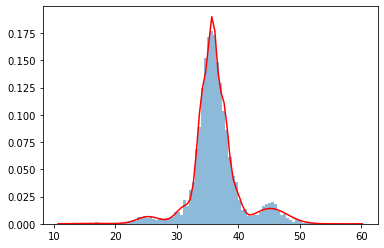

In [37]:
n_components=8
from sklearn.mixture import GaussianMixture
clf = GaussianMixture(n_components=n_components,max_iter=100, random_state=1,covariance_type='full',init_params='kmeans').fit(I_atoms.reshape(-1,1))

xpdf=np.linspace(I_atoms.min(),I_atoms.max(),100).reshape(-1,1)

density = np.exp(clf.score_samples(xpdf))

plt.hist(I_atoms, 100, density=True, alpha=0.5)
plt.plot(xpdf, density, '-r')
#plt.plot(intensity,x)
#plt.plot(xpdf, 0.0004*density, '-r')
print(clf.score(I_atoms.reshape(-1,1)))

In [38]:
gmm_zp=clf.predict(I_atoms.reshape(-1,1))

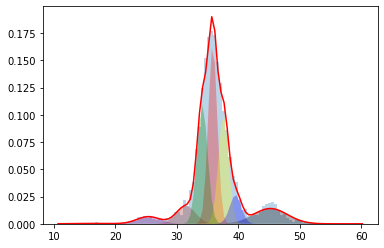

In [39]:
from scipy import stats
colors=['red','black','brown','yellow','purple','blue','green','orange']
plt.hist(I_atoms, 100, density=True, alpha=0.3)
plt.plot(xpdf, density, '-r')

for i in range(clf.n_components):
    pdf = clf.weights_[i] * stats.norm(clf.means_[i, 0],
                                       np.sqrt(clf.covariances_[i, 0])).pdf(xpdf)
    plt.fill(xpdf, pdf, facecolor=colors[i], #colors[i],
            edgecolor='none', alpha=0.3)

In [40]:
V_counts=0
V_positions=np.zeros((1,2))
for i in np.arange(n_components):
  if clf.means_[i]<26:
    V_counts+=len(xy3[np.where(gmm_zp==i)])
    V_positions=np.append(V_positions,xy3[np.where(gmm_zp==i)],axis=0)
    print(clf.means_[i])
V_positions=np.delete(V_positions,0,0)
print(n_components)

[25.37729418]
[16.63438581]
8


In [41]:
print(V_positions.shape)

(162, 2)


"\nax[1].imshow(data2)\nax[1].scatter(xy2_refined[:,1],xy2_refined[:,0],s=5,c='r')\nax[1].set_title('after position refinement')\n"

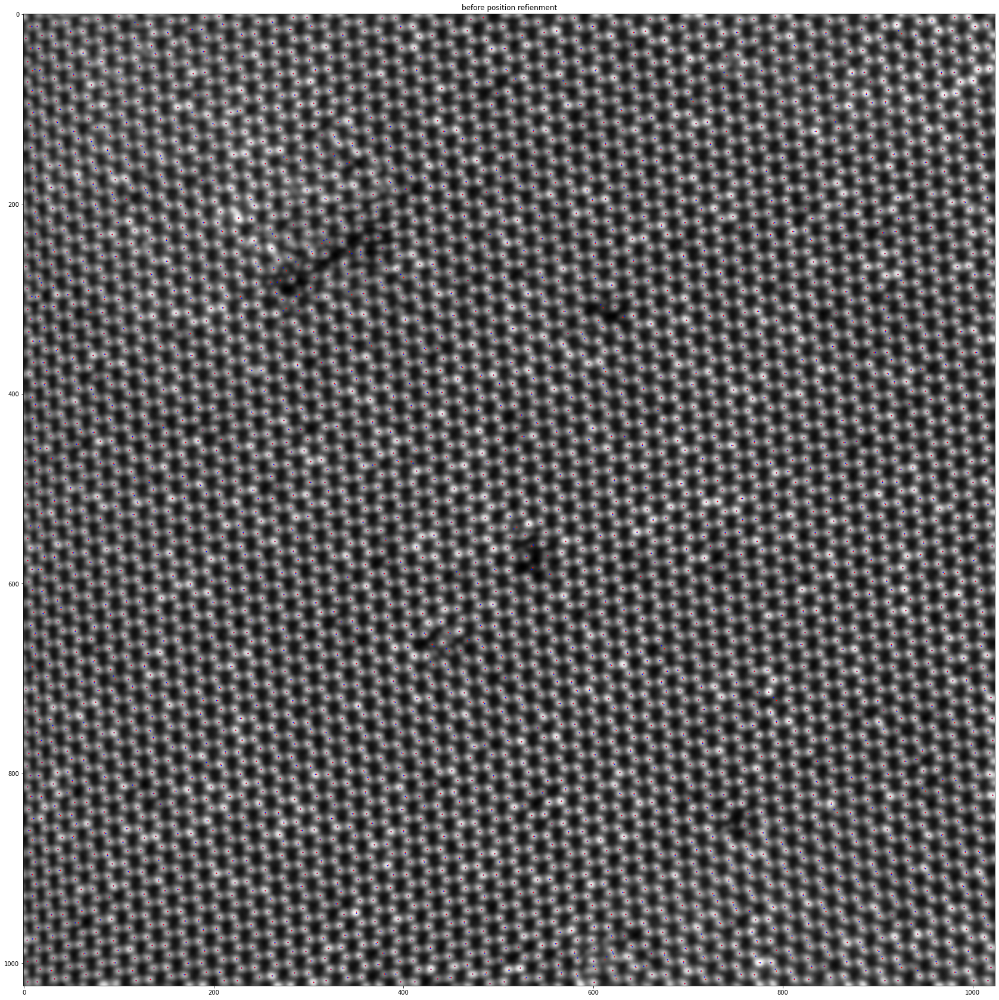

In [42]:
#fig,ax=plt.figure(figsize=(20,20))

fig, ax = plt.subplots(1, 1, figsize=(30,30))

ax.imshow(data2)
#ax.scatter(xy2[:,1],xy2[:,0],s=1,c='r')
ax.scatter(xy2_refined[:,1],xy2_refined[:,0],s=1,c='b')
ax.scatter(xy2[:,1],xy2[:,0],s=1,c='r')
ax.set_title('before position refienment')
'''
ax[1].imshow(data2)
ax[1].scatter(xy2_refined[:,1],xy2_refined[:,0],s=5,c='r')
ax[1].set_title('after position refinement')
'''

Should be refined in a better way...
Let's adopt the pre-refined coordinates

In [43]:
xy2_refined=xy2

In [44]:
xy.shape

(2461, 2)

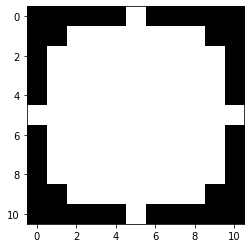

In [45]:
import math

wind_size2=11

mask_circle=np.zeros((wind_size2,wind_size2))

h,w=mask_circle.shape
y_center=math.floor(h/2)
x_center=math.floor(w/2)
mask=np.zeros((h,w))

r_crit=math.floor(h/2)


for i in np.arange(w):
   for j in np.arange(h):
     if (i-x_center)**2 + (j-y_center)**2 <=r_crit**2:
        mask[i,j]=1

plt.imshow(mask)
#plt.colorbar()


Refine the hole coordinates


In [46]:
data_inverted.shape
# copy the xy content to xy_refined without tieing their addresses together

xy_refined=xy.copy()

for jj, x_y in enumerate(xy):
  x=x_y[0]
  y=x_y[1]
  if x-5>=0 and x+6<=data_inverted.shape[0]-1 and y-5>=0 and y+6<=data_inverted.shape[1]-1:
    data2_area_max=np.sum(np.sum(data_inverted[x-5:x+6,y-5:y+6]*mask))
    data2_area_max_init=data2_area_max
    for i in np.arange(-4,4,1):
      for j in np.arange(-4,4,1):
         if (x-5+i)>=0 and x+6+i<=data_inverted.shape[0]-1 and y-5+j>=0 and y+6+j<=data_inverted.shape[1]-1: #if the area is not beyond the edge
            masked_area=data_inverted[x-5+i:x+6+i,y-5+j:y+6+j]*mask
            if np.sum(np.sum(masked_area))>data2_area_max:
              data2_area_max=np.sum(np.sum(masked_area))
              xy_refined[jj,0]=x+i
              xy_refined[jj,1]=y+j
    if data2_area_max!=data2_area_max_init: # if the refined coordinates are different from the original xy2
      print(jj,data2_area_max,xy_refined[jj,0],xy_refined[jj,1])
      print(jj,np.sum(np.sum(data2[x-5:x+6,y-5:y+6]*mask)),x,y)

3 71.31384090334177 1017 612
3 9.838527105748653 1016 612
5 72.40572594851255 1015 236
5 8.657468818128109 1016 236
6 72.89114072173834 1016 144
6 8.486065417528152 1016 143
7 69.09949437528849 1017 23
7 11.987562619149685 1016 23
8 69.94781471788883 1015 838
8 11.279846340417862 1015 839
9 72.10355422645807 1014 555
9 9.303392507135868 1015 554
10 73.12176706269383 1015 933
10 8.054852928966284 1014 933
12 58.92305663228035 1013 592
12 22.53446465730667 1014 592
13 74.84555293992162 1013 368
13 6.621693465858698 1014 367
14 68.53209882229567 1014 650
14 12.903878726065159 1013 651
15 68.10881920903921 1011 782
15 13.034553565084934 1012 782
16 71.86583846062422 1013 54
16 9.231409065425396 1012 54
17 70.80249547958374 1011 970
17 10.22876264154911 1011 969
18 71.38793558627367 1010 876
18 9.865767650306225 1011 875
19 71.51174020022154 1014 460
19 11.092991657555103 1011 461
20 70.16661687940359 1009 687
20 10.885480500757694 1010 688
21 72.75343389436603 1011 274
21 8.597385417670012

In [47]:
xy.shape

(2461, 2)

In [48]:
sum=0
count=0
for i in np.arange(xy_refined.shape[0]):
    sum+=abs(np.sum(xy_refined[i,:]-xy[i,:]))
    if xy_refined[i,0]-xy[i,0]!=0 and xy_refined[i,1]-xy[i,1]!=0:
      count+=1
      print(sum)
      print(count)
       

print(sum)

5
1
7
2
7
3
10
4
12
5
14
6
15
7
15
8
23
9
24
10
27
11
34
12
36
13
49
14
49
15
49
16
51
17
51
18
51
19
55
20
60
21
64
22
77
23
82
24
85
25
92
26
95
27
96
28
99
29
104
30
106
31
108
32
110
33
111
34
112
35
115
36
119
37
121
38
123
39
128
40
135
41
138
42
138
43
143
44
146
45
149
46
152
47
152
48
161
49
165
50
170
51
174
52
174
53
174
54
175
55
176
56
181
57
182
58
190
59
194
60
198
61
199
62
201
63
205
64
217
65
223
66
227
67
231
68
233
69
233
70
236
71
238
72
240
73
244
74
250
75
254
76
266
77
266
78
271
79
279
80
283
81
287
82
290
83
292
84
293
85
294
86
295
87
297
88
304
89
304
90
307
91
312
92
313
93
317
94
324
95
325
96
328
97
331
98
332
99
341
100
344
101
345
102
347
103
350
104
355
105
355
106
355
107
365
108
367
109
373
110
375
111
387
112
391
113
394
114
398
115
404
116
406
117
407
118
411
119
419
120
419
121
422
122
424
123
427
124
435
125
439
126
440
127
443
128
445
129
449
130
453
131
453
132
457
133
463
134
471
135
472
136
475
137
475
138
476
139
479
140
479
141
482
142
483


(2461, 2)


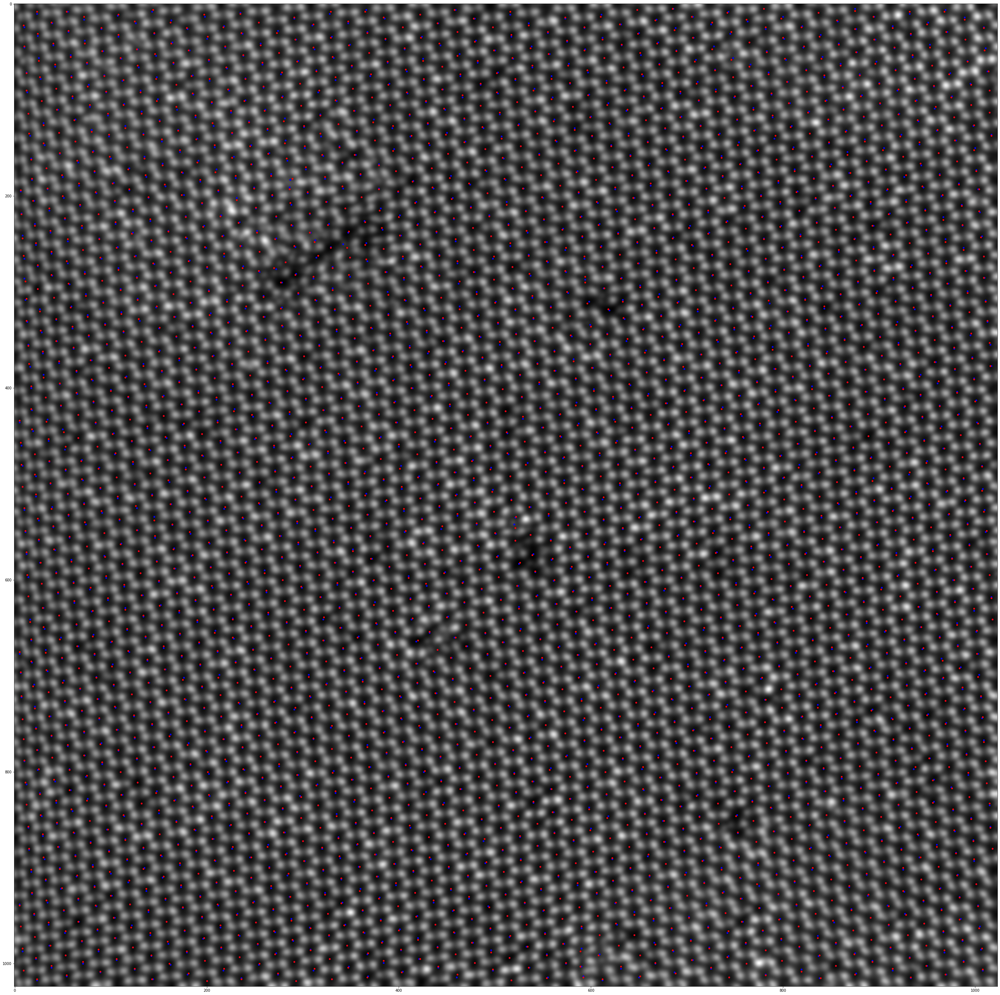

In [49]:

plt.figure(figsize=(50,50))
plt.scatter(xy_refined[:,1],xy_refined[:,0],s=15,c='b')
plt.scatter(xy[:,1],xy[:,0],s=15,c='r')
plt.imshow(YG_data_norm,cmap='gray')
print(xy_refined.shape)

In [50]:
atom_size=17

Create a sematic image with each atom having the same Gaussian distribution

2D Gaussian-like array:
(17, 17)


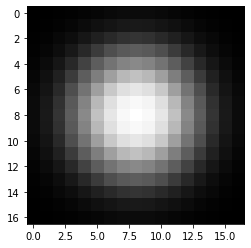

In [51]:
# create a 2d Gaussian distribution
x, y = np.meshgrid(np.linspace(-1,1,atom_size), np.linspace(-1,1,atom_size))
d = np.sqrt(x*x+y*y)
sigma, mu = 0.4, 0.0
g = np.exp(-( (d-mu)**2 / ( 2.0 * sigma**2 ) ) )
print("2D Gaussian-like array:")
print(g.shape)
plt.imshow(g)

In [52]:

r_atom=math.floor(atom_size/2)
print(r_atom)

8


In [53]:
xy2.shape

(4962, 2)

In [54]:
print(V_positions)

[[1016.  436.]
 [1011.  381.]
 [1007.  942.]
 [1003.  843.]
 [ 993.  614.]
 [ 997.  503.]
 [ 989.  661.]
 [ 990.  566.]
 [ 989.  379.]
 [ 986.  793.]
 [ 971.  632.]
 [ 957.  745.]
 [ 957.   54.]
 [ 949.  915.]
 [ 945.  765.]
 [ 937.  329.]
 [ 930.   90.]
 [ 862.  765.]
 [ 854.  760.]
 [ 853.  556.]
 [ 842.  764.]
 [ 832.  144.]
 [ 828.  701.]
 [ 820.  546.]
 [ 815.  947.]
 [ 812.  114.]
 [ 810.  433.]
 [ 806.  968.]
 [ 788.   19.]
 [ 787.  836.]
 [ 785.  940.]
 [ 778.    5.]
 [ 755.  920.]
 [ 755.  720.]
 [ 752.  541.]
 [ 737.  963.]
 [ 736.  881.]
 [ 734.  303.]
 [ 733.  906.]
 [ 720.  790.]
 [ 715.  775.]
 [ 697.   94.]
 [ 699.  507.]
 [ 689.  998.]
 [ 688.    6.]
 [ 682.  428.]
 [ 668.  445.]
 [ 670.  460.]
 [ 669.   78.]
 [ 665.  672.]
 [ 661.  347.]
 [ 640.  334.]
 [ 632.  596.]
 [ 606.    9.]
 [ 596.  813.]
 [ 593.  341.]
 [ 592.  744.]
 [ 592.  650.]
 [ 590.  554.]
 [ 587.  456.]
 [ 583.  724.]
 [ 581.  549.]
 [ 577.  385.]
 [ 571.  529.]
 [ 570.  552.]
 [ 569.  743.]
 [ 569.  6

In [55]:
xy2_refined_copy=xy2.copy()
print(xy2_refined_copy.shape)

(4962, 2)


In [56]:
for i, (x2,y2) in enumerate(xy2_refined_copy):
  for j, (x1,y1) in enumerate(V_positions):
    if x2==x1 and y2==y1:
       xy2_refined_copy[i]=(0,0)

print(xy2_refined_copy.shape)

(4962, 2)


In [57]:
length=xy2_refined_copy[np.where(xy2_refined_copy!=[0,0])].shape[0]/2

In [58]:
xy2_atoms=xy2_refined_copy[np.where(xy2_refined_copy!=[0,0])].reshape(int(length),2)

In [59]:
print(V_positions.shape)
print(xy2_atoms.shape)
print(xy2_refined_copy.shape)

(162, 2)
(4918, 2)
(4962, 2)


In [60]:
V_positions.astype('int')
xy2_atoms.astype('int')

array([[1021,  696],
       [1021,  491],
       [1020,  601],
       ...,
       [   2,  792],
       [   2,  205],
       [   2,  100]])

In [61]:
print(xy2_refined_copy.shape)
print(xy2_atoms.shape)
print(V_positions.shape)

(4962, 2)
(4918, 2)
(162, 2)


In [62]:
plt.set_cmap('gray')

<Figure size 432x288 with 0 Axes>

In [63]:
# semantic_image=np.zeros((YG_data_norm.shape[0],YG_data_norm.shape[1]))
# for j, x_y in enumerate(xy2_atoms):
#    x=x_y[0].astype('int')
#    y=x_y[1].astype('int')
#    if x-r_atom>0 and x+r_atom+1<=semantic_image.shape[0]-1 and y-r_atom>0 and y+r_atom+1<=semantic_image.shape[1]-1:
#          semantic_image[x-r_atom:x+r_atom+1,y-r_atom:y+r_atom+1]=g+semantic_image[x-r_atom:x+r_atom+1,y-r_atom:y+r_atom+1]

# for j, x_y in enumerate(V_positions):
#    x=x_y[0].astype('int')
#    y=x_y[1].astype('int')
#    if x-r_atom>0 and x+r_atom+1<=semantic_image.shape[0]-1 and y-r_atom>0 and y+r_atom+1<=semantic_image.shape[1]-1:
#       semantic_image[x-r_atom:x+r_atom+1,y-r_atom:y+r_atom+1]=0.5*g+semantic_image[x-r_atom:x+r_atom+1,y-r_atom:y+r_atom+1]

# plt.figure(figsize=(50,50))
# plt.imshow(semantic_image)
# plt.scatter(xy_refined[:,1],xy_refined[:,0])

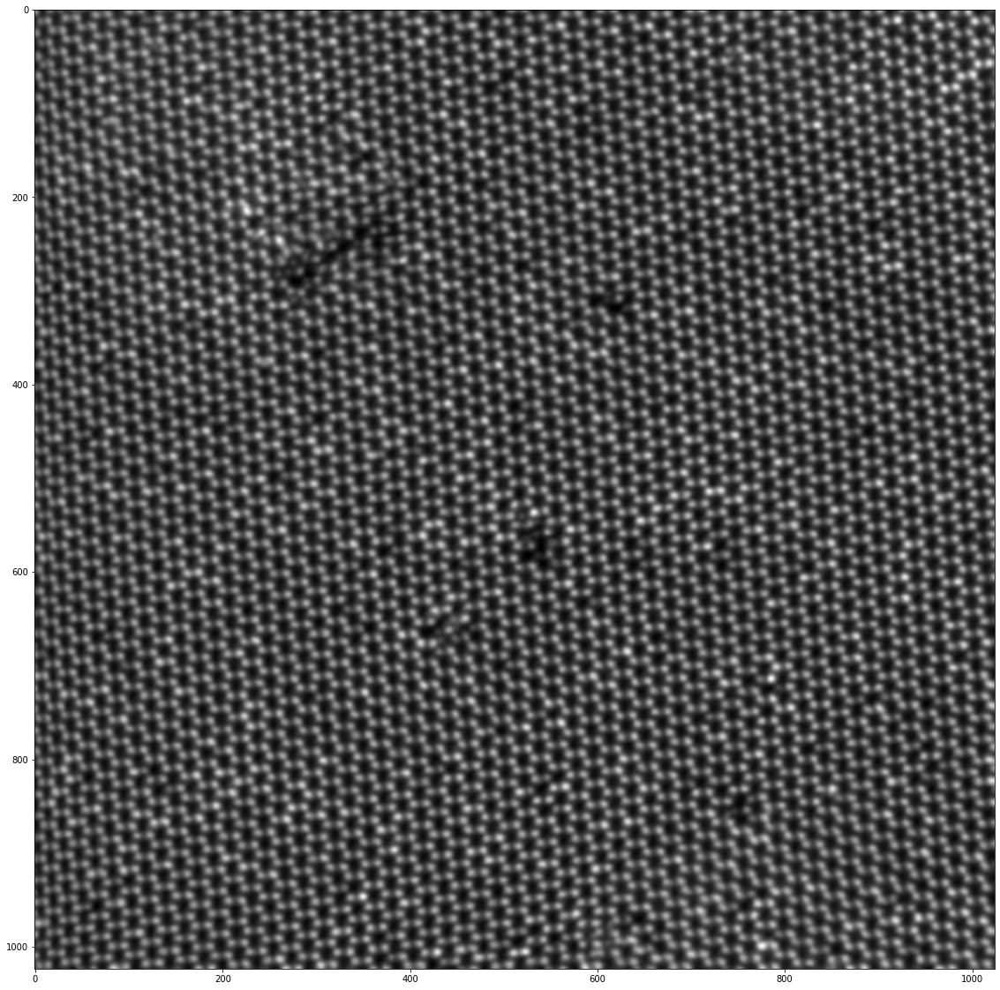

In [64]:
plt.figure(figsize=(20,20))
plt.imshow(YG_data)

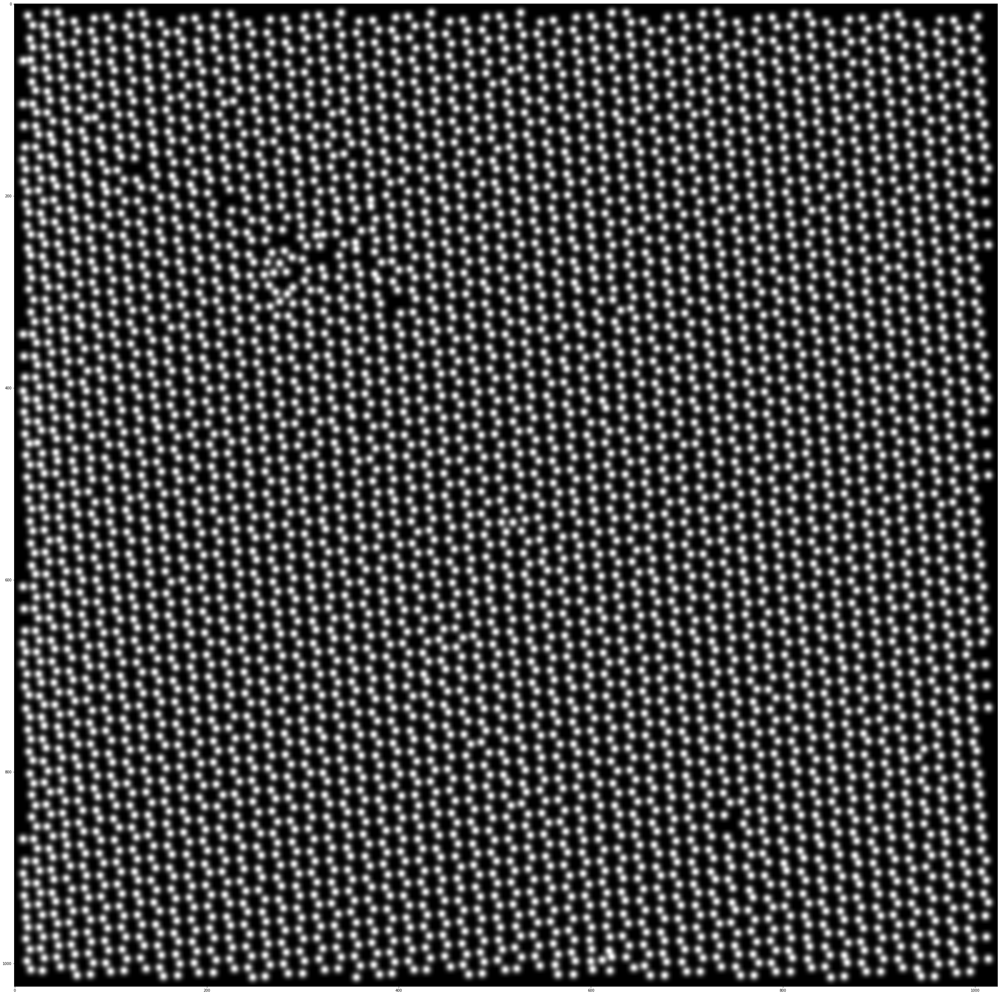

In [65]:
semantic_image=np.zeros((YG_data_norm.shape[0],YG_data_norm.shape[1]))
for j, x_y in enumerate(xy2_refined):
   x=x_y[0]
   y=x_y[1]
   if x-r_atom>0 and x+r_atom+1<=semantic_image.shape[0]-1 and y-r_atom>0 and y+r_atom+1<=semantic_image.shape[1]-1:
         semantic_image[x-r_atom:x+r_atom+1,y-r_atom:y+r_atom+1]=g+semantic_image[x-r_atom:x+r_atom+1,y-r_atom:y+r_atom+1]
      # if (x,y) in V_positions: 
      #   semantic_image[x-r_atom:x+r_atom+1,y-r_atom:y+r_atom+1]=-0.3*g+semantic_image[x-r_atom:x+r_atom+1,y-r_atom:y+r_atom+1]

plt.figure(figsize=(50,50))
plt.imshow(semantic_image)

In [66]:
YG_data_norm.shape

(1024, 1024)

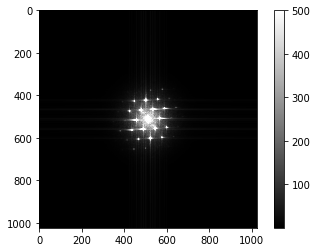

In [67]:
FFT_whole=scipy.fft.fft2(YG_data_norm)
FFT_whole_shift=scipy.fft.fftshift(FFT_whole)
plt.imshow(abs(FFT_whole_shift),vmax=500)
plt.colorbar()

# Prepare datasets for training

Crop the smoothed STEM images into subimages

In [68]:
#expdata=YG_data_norm.copy()
expdata=semantic_image.copy()

In [69]:
size_subimages=37

create a circular mask

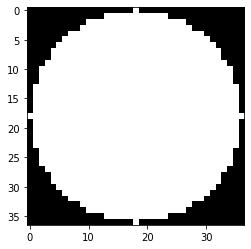

In [70]:
import math

wind_size2=size_subimages

mask_circle=np.zeros((wind_size2,wind_size2))

h,w=mask_circle.shape
y_center=math.floor(h/2)
x_center=math.floor(w/2)
mask2=np.zeros((h,w))

r_crit=math.floor(h/2)


for i in np.arange(w):
   for j in np.arange(h):
     if (i-x_center)**2 + (j-y_center)**2 <=r_crit**2:
        mask2[i,j]=1

plt.imshow(mask2)
#plt.colorbar()


## Prepare the image stack

In [71]:
semantic_image.shape[1]-size_subimages

987

In [72]:
collection=np.zeros((size_subimages,size_subimages,1))
coord_collection=np.zeros((1,2))
for i in np.arange(np.shape(xy_refined)[0]): #xy_refined is the collection of hole positions
   y1=int(xy_refined[i,0]-size_subimages/2)
   y2=y1+size_subimages
   x1=int(xy_refined[i,1]-size_subimages/2)
   x2=x1+size_subimages
   if y1>=30 and y2<=1000 and x1>=30 and x2<=1000:
  #  if y1>=size_subimages and y2<=(semantic_image.shape[1]-size_subimages) and x1>=size_subimages and x2<=(semantic_image-size_subimages):
         subimage_i=normalize_image(expdata)[y1:y2,x1:x2] # YG_data_norm, expdata 
         collection=np.append(collection, np.atleast_3d(subimage_i), axis=2)
         row=xy_refined[i][0]
         col=xy_refined[i][1]
         coord_collection=np.vstack([coord_collection,[row,col]])

In [73]:
new_collection=np.delete(collection, 0, axis=2)
new_coord_collection=np.delete(coord_collection,0,axis=0)

Create a image stack so that each image only contains complete atoms

In [74]:
print(r_atom)

8


In [75]:
# imgstack=np.zeros((size_subimages+2*r_atom,size_subimages+2*r_atom,np.shape(xy_refined)[0]))
# coord_stack=np.zeros((1,2))

# print(imgstack.shape[0])

# for i in np.arange(np.shape(xy_refined)[0]):
#      y1=int(xy_refined[i,0]-size_subimages/2)
#      y2=y1+size_subimages
#      x1=int(xy_refined[i,1]-size_subimages/2)
#      x2=x1+size_subimages
#      for x in range(x1,x2+1):
#        for y in range(y1,y2+1):
#          for xy in xy2_refined:
#            if x==xy[0] and y==xy[1] and x-r_atom>0 and x+r_atom+1<=semantic_image.shape[0]-1 and y-r_atom>0 and y+r_atom+1<=semantic_image.shape[1]-1:       
#               print(x,y)
#               print(x1,y1)
#               print(x-x1+r_atom)
#               print(imgstack[x-x1-r_atom:x-x1-r_atom+atom_size,y-y1-r_atom:y-y1-r_atom+atom_size,i].shape)
#               imgstack[x-x1+r_atom:x-x1+r_atom+atom_size,y-y1+r_atom:y-y1+r_atom+atom_size,i]=imgstack[x-x1+r_atom:x-x1+r_atom+atom_size,y-y1+r_atom:y-y1+r_atom+atom_size,i]+g

In [76]:
print(new_collection.shape)

(37, 37, 2063)


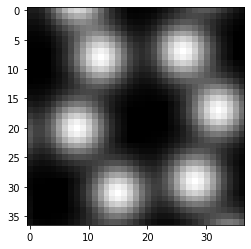

In [77]:
plt.imshow(new_collection[:,:,100])

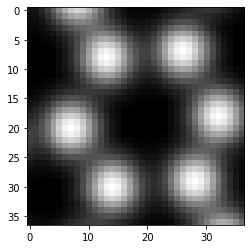

In [78]:
plt.imshow(new_collection[:,:,1])

transpose the datamatrix to (#_of_sample,row,col)

(2063, 37, 37)
(2063, 1369)


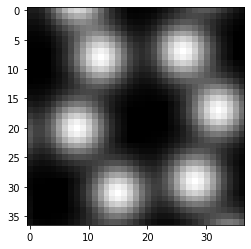

In [79]:
img_stack_init=new_collection.transpose(2,0,1)
plt.imshow(img_stack_init[100,:,:])
print(img_stack_init.shape)
img_stack_init_flat=img_stack_init.reshape(img_stack_init.shape[0],img_stack_init.shape[1]*img_stack_init.shape[2])
print(img_stack_init_flat.shape)

# Use Patterson function of each subimage as the img_stack

With the same size as input image and with periodic boundary condition wrapped up

In [80]:
def Patterson_function(semantic_image):
   FFT=scipy.fft.fft2(semantic_image)
   patterson=scipy.fft.ifft2(abs(FFT)**2)
   patt=scipy.fft.ifftshift(patterson)
   # patt=patterson
   Patterson=abs(patt)
  #  plt.imshow(Patterson,vmax=100)
  #  plt.colorbar()
   return Patterson

The patterson function with periodic boundary wrapped up

Patterson function by FFT

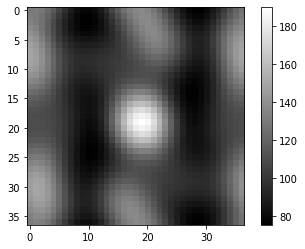

In [81]:
import scipy
img_stack=np.zeros((img_stack_init.shape[0],img_stack_init.shape[1],img_stack_init.shape[2]))
for j in np.arange(img_stack_init.shape[0]):
  # FFT=scipy.fft.fft2(img_stack_init[j,:,:])
  # patterson=scipy.fft.ifft2(abs(FFT)**2)
  # patt=scipy.fft.ifftshift(patterson)
  # # patt=patterson
  # img_stack[j,:,:]=abs(patt)
    img_stack[j,:,:]=Patterson_function(img_stack_init[j,:,:])
plt.imshow(img_stack[100,:,:])
plt.colorbar()

Patterson function by convolution 

In [82]:
import scipy.signal
def Patterson_function2(image):
   image_invert=np.fliplr(np.flipud(image))
   output=scipy.signal.convolve2d(image,image_invert,mode='full',boundary='fill')
   return output

In [83]:
img_stack=[]
for j in np.arange(img_stack_init.shape[0]):
    img_stack.append(Patterson_function2(img_stack_init[j,:,:]))

img_stack=np.array(img_stack)

display

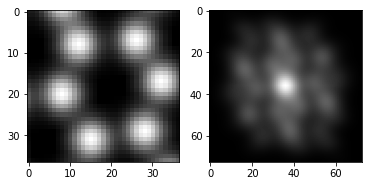

In [84]:
img_stack.shape
fig,ax=plt.subplots(1,2)
ax[0].imshow(img_stack_init[100,:,:])
ax[1].imshow(img_stack[100,:,:])

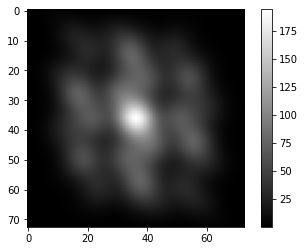

In [85]:
plt.imshow(np.mean(img_stack,axis=0))
plt.colorbar()

Image stack

In [86]:
img_stack_flat=img_stack.reshape(img_stack.shape[0],img_stack.shape[1]*img_stack.shape[2])
img_stack_flat.shape
# img_stack_flat.dtype

(2063, 5329)

dimension reduction using PCA

In [87]:
from sklearn.decomposition import PCA
pca=PCA()
pca.fit(img_stack_flat[:,:])              
# pca.fit(img_stack_init_flat[:,:])
explained_var = pca.explained_variance_ratio_
sum=0
nc=0
i=0
while sum<0.95:
    print(str(i+1)+'th component accounts for:'+str(explained_var[i]))
    sum=sum+explained_var[i]
    nc=nc+1
    i=i+1
print(str(nc)+'components can explain'+str(sum)+'of the behavior')

NC=nc
pca = PCA(n_components=NC)
X_vec_t = pca.fit_transform(img_stack_flat[:,:])
components = pca.components_

print('shape of the components is')
print(components.shape)
print(X_vec_t.shape)

1th component accounts for:0.3463763966868686
2th component accounts for:0.19307923160800816
3th component accounts for:0.126853457247417
4th component accounts for:0.08735308206605398
5th component accounts for:0.0792701101001179
6th component accounts for:0.042564408031304776
7th component accounts for:0.026727879475951233
8th component accounts for:0.014408241134914289
9th component accounts for:0.012728592955187338
10th component accounts for:0.012178919518185673
11th component accounts for:0.007268673038764248
12th component accounts for:0.006487224955195205
12components can explain0.9552962168179684of the behavior
shape of the components is
(12, 5329)
(2063, 12)


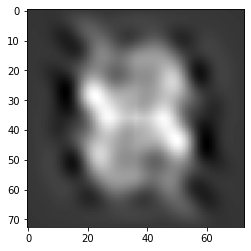

In [88]:
plt.set_cmap('gray')
plt.imshow(components[0,:].reshape(73,73))

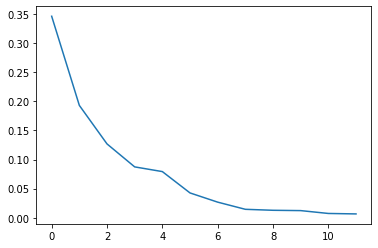

In [89]:
plt.plot(explained_var[:NC])

scree plot

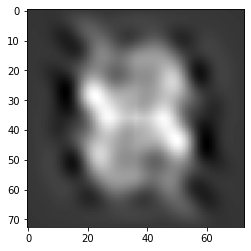

In [90]:
plt.imshow(components.reshape(NC,img_stack.shape[1],img_stack.shape[2])[0,:,:])

# Outlier detection by SVM 

Using SVM for outlier detection

In [91]:
# cate[100]
# np.where(cate==-1)

In [92]:
# img_stack_init_flat.reshape(img_stack.shape[0],img_stack.shape[1],img_stack.shape[2])[np.where(cate==-1)].shape

In [93]:
from sklearn.svm import OneClassSVM
clf=OneClassSVM(gamma='scale',nu=0.025,max_iter=-1).fit(X_vec_t)
cate=clf.predict(X_vec_t)
scores=clf.score_samples(X_vec_t)
score_tot=np.sum(scores)
print(score_tot)

3183.221740383691


(array([  3.,   2.,   1.,   2.,   1.,   0.,   1.,   0.,   1.,   0.,   1.,
          0.,   0., 104.,   6.,   6.,   6.,   4.,   3.,   3.,   1.,   4.,
          7.,   7.,   7.,  10.,  10.,   9.,   5.,   6.,   6.,   5.,   9.,
         12.,  10.,   8.,  12.,   8.,  10.,  19.,  12.,   8.,  16.,  16.,
         15.,  16.,  14.,  19.,  13.,  22.,  19.,  22.,  37.,  19.,  28.,
         23.,  22.,  33.,  35.,  36.,  42.,  32.,  28.,  43.,  47.,  43.,
         42.,  49.,  48.,  42.,  41.,  51.,  43.,  33.,  43.,  48.,  41.,
         35.,  40.,  51.,  31.,  38.,  37.,  45.,  41.,  27.,  39.,  42.,
         33.,  34.,  30.,  20.,  22.,  14.,  12.,   7.,   8.,   4.,   2.,
          1.]),
 array([1.00004581, 1.00861763, 1.01718946, 1.02576128, 1.0343331 ,
        1.04290493, 1.05147675, 1.06004858, 1.0686204 , 1.07719223,
        1.08576405, 1.09433587, 1.1029077 , 1.11147952, 1.12005135,
        1.12862317, 1.137195  , 1.14576682, 1.15433865, 1.16291047,
        1.17148229, 1.18005412, 1.18862594, 1.

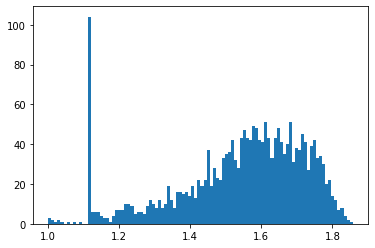

In [94]:
plt.hist(scores,bins=100)

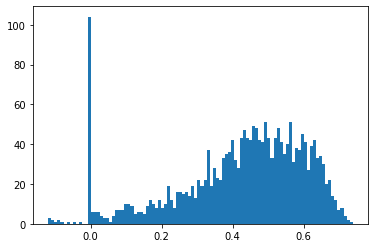

In [95]:
decision_f=clf.decision_function(X_vec_t)
plt.hist(decision_f,bins=100)
cate=clf.predict(X_vec_t)

In [96]:
Q1=np.median(decision_f[np.where(decision_f<np.median(decision_f))])
Q3=np.median(decision_f[np.where(decision_f>np.median(decision_f))])
lower_limit=Q1-(Q3-Q1)*1.5
print(lower_limit)
decision_f[np.where(decision_f<lower_limit)].shape[0]

-0.017879835329087657


12

In [97]:
decision_f[np.where(decision_f<0)].shape

(68,)

Text(0, 0.5, '# of outliers')

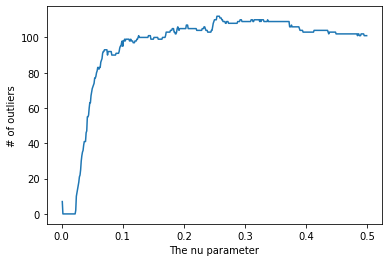

In [98]:
Number_of_outliers=[]
nu_min=0.001
nu_max=0.5
for i, nu in enumerate(np.arange(nu_min,nu_max,0.001)):
  clf=OneClassSVM(gamma='scale',nu=nu,max_iter=-1).fit(X_vec_t)
  decision_f=clf.decision_function(X_vec_t)
  Q1=np.median(decision_f[np.where(decision_f<np.median(decision_f))])
  Q3=np.median(decision_f[np.where(decision_f>np.median(decision_f))])
  lower_limit=Q1-(Q3-Q1)*1.45
  num_outliers=decision_f[np.where(decision_f<lower_limit)].shape[0]
  Number_of_outliers.append(num_outliers)

Number_of_outliers=np.array(Number_of_outliers)
plt.plot(np.arange(nu_min,nu_max,0.001),Number_of_outliers)
plt.xlabel('The nu parameter')
plt.ylabel('# of outliers')

Text(0, 0.5, '# of outliers')

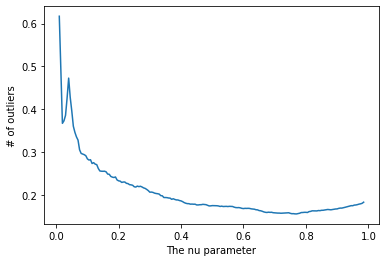

In [99]:

nu_min=0.01
nu_max=0.99
nu_step=0.005
#the number of nu i the horizontal direction
nu_num=(nu_max-nu_min)/nu_step
nu_num=int(nu_num)
gamma_0=1/(X_vec_t.shape[1]*X_vec_t[:,:].var())
gamma_ratios=np.arange(0.5,3,0.5)
#the number of gamma
gamma_num=len(gamma_ratios)

Dvs=np.zeros((gamma_num,nu_num))

for j,gamma_ratio in enumerate(gamma_ratios):
   for i, nu in enumerate(np.arange(nu_min,nu_max,nu_step)):
      clf=OneClassSVM(gamma=gamma_ratio*gamma_0,nu=nu,max_iter=-1).fit(X_vec_t)
      decision_f=clf.decision_function(X_vec_t)
      P1=np.median(decision_f[np.where(decision_f<=0)])
      P2=np.median(decision_f[np.where(decision_f>0)])
      Dv=(P2-P1)/(decision_f.max()-decision_f.min())
      Dvs[j,i]=Dv
    

plt.plot(np.arange(nu_min,nu_max,nu_step),Dvs[0,:])
plt.xlabel('The nu parameter')
plt.ylabel('# of outliers')

$\nu$

1.5


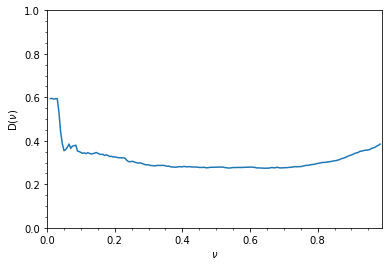

In [100]:
ratio_rank=2
plt.plot(np.arange(nu_min,nu_max,nu_step),Dvs[ratio_rank,:])
plt.xlabel(r'$\nu$')
plt.ylabel('D('r'$\nu$'')')
plt.xlim(0.0,0.99)
plt.minorticks_on()
plt.ylim(0,1)
print(gamma_ratios[ratio_rank])

(array([ 10.,   1.,   1.,   0.,   1.,   0.,   0.,   2.,   1.,   1.,   0.,
          2.,   0.,   1.,   0.,   0.,   1.,   2.,   0.,   1.,   1.,   0.,
          1.,   0.,   1., 105.,  44.,   9.,   8.,   6.,   7.,   9.,   8.,
         11.,   5.,  10.,   8.,  13.,  12.,   7.,   9.,   8.,   9.,  13.,
         19.,  21.,  21.,  15.,   9.,  22.,  26.,  22.,  25.,  17.,  28.,
         33.,  37.,  28.,  17.,  31.,  39.,  30.,  37.,  34.,  39.,  39.,
         30.,  54.,  35.,  40.,  53.,  45.,  39.,  45.,  51.,  49.,  44.,
         43.,  44.,  48.,  52.,  39.,  43.,  44.,  51.,  47.,  42.,  42.,
         25.,  21.,  26.,  27.,  19.,  12.,  12.,   3.,  10.,   5.,   3.,
          3.]),
 array([-3.02477825e-01, -2.90837777e-01, -2.79197729e-01, -2.67557681e-01,
        -2.55917633e-01, -2.44277585e-01, -2.32637537e-01, -2.20997489e-01,
        -2.09357441e-01, -1.97717393e-01, -1.86077345e-01, -1.74437297e-01,
        -1.62797249e-01, -1.51157201e-01, -1.39517153e-01, -1.27877105e-01,
        -1.162

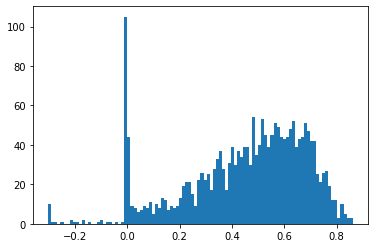

In [101]:
from sklearn.svm import OneClassSVM
clf=OneClassSVM(gamma=gamma_ratios[ratio_rank]*gamma_0,nu=0.04,max_iter=-1).fit(X_vec_t[:,:])
cate=clf.predict(X_vec_t[:,:])
decision_f=clf.decision_function(X_vec_t[:,:])
scores=clf.score_samples(X_vec_t[:,:])
score_tot=np.sum(scores)
plt.hist(decision_f,bins=100)

(array([ 14.,   0.,   0.,   1.,   1., 172.,   4.,   5.,   7.,   4.,   7.,
          8.,   5.,   6.,   8.,   9.,   9.,   3.,   7.,  10.,   7.,   4.,
         12.,  10.,   9.,  10.,   5.,  13.,  15.,  11.,  10.,  12.,  15.,
         13.,  18.,  15.,  17.,  22.,  18.,  25.,  18.,  17.,  18.,  26.,
         20.,  20.,  34.,  27.,  17.,  24.,  19.,  34.,  22.,  39.,  24.,
         30.,  43.,  27.,  33.,  39.,  28.,  28.,  33.,  33.,  32.,  37.,
         29.,  38.,  45.,  42.,  39.,  29.,  40.,  30.,  31.,  40.,  33.,
         35.,  44.,  32.,  30.,  39.,  34.,  23.,  24.,  19.,  23.,  20.,
         12.,  12.,  17.,   7.,   8.,   6.,   6.,   5.,   4.,   0.,   3.,
          1.]),
 array([-0.0472573 , -0.03911259, -0.03096788, -0.02282317, -0.01467846,
        -0.00653374,  0.00161097,  0.00975568,  0.01790039,  0.0260451 ,
         0.03418981,  0.04233452,  0.05047923,  0.05862395,  0.06676866,
         0.07491337,  0.08305808,  0.09120279,  0.0993475 ,  0.10749221,
         0.11563693,  0.12

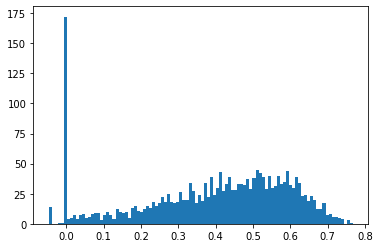

In [102]:
from sklearn.svm import OneClassSVM
clf=OneClassSVM(gamma=gamma_ratios[ratio_rank]*gamma_0,nu=0.04,max_iter=-1).fit(img_stack_flat[:,:])
cate=clf.predict(img_stack_flat[:,:])
decision_f=clf.decision_function(img_stack_flat[:,:])
scores=clf.score_samples(img_stack_flat[:,:])
score_tot=np.sum(scores)
plt.hist(decision_f,bins=100)

In [103]:
# plt.plot(np.arange(nu_min,nu_max,nu_step),Dvs)
# plt.xlabel('The nu parameter')
# plt.ylabel('# of outliers')
# plt.xlim(0,0.1)
# plt.ylim(0,1)

In [104]:
# plt.plot(np.arange(nu_min,nu_max,0.001),Number_of_outliers)
# plt.ylim(0,200)
# plt.xlim(0,0.1)
# plt.xlabel('The nu parameter')
# plt.ylabel('Number of outliers')

In [105]:
nu_opt=np.mean(Number_of_outliers/xy_refined.shape[0])
print(nu_opt)
nu_opt=0.05

0.03848493411039877


Text(0, 0.5, 'Number of outliers')

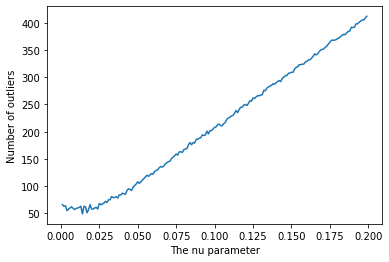

In [106]:
Number_of_outliers=[]
nu_min=0.001
nu_max=0.2
for i, nu in enumerate(np.arange(nu_min,nu_max,0.001)):
  clf=OneClassSVM(gamma='scale',nu=nu,max_iter=-1).fit(X_vec_t)
  decision_f=clf.decision_function(X_vec_t)
  num_outliers=decision_f[np.where(decision_f<0)].shape[0]
  Number_of_outliers.append(num_outliers)

Number_of_outliers=np.array(Number_of_outliers)
plt.plot(np.arange(nu_min,nu_max,0.001),Number_of_outliers)
plt.xlabel('The nu parameter')
plt.ylabel('Number of outliers')

**Great! This shows that the fraction of outliers can be determined automatically as well. This is completely unsupervised learning!**

Text(0, 0.5, '# of data points')

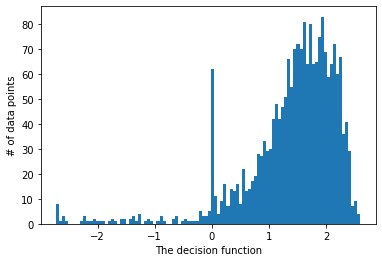

In [107]:
nu_opt=nu_opt
clf=OneClassSVM(gamma='scale',nu=nu_opt,max_iter=-1).fit(X_vec_t)
cate=clf.predict(X_vec_t)
decision_f=clf.decision_function(X_vec_t)
plt.hist(decision_f,bins=100)
plt.xlabel('The decision function')
plt.ylabel('# of data points')

In [108]:
nu_opt=nu_opt
clf=OneClassSVM(gamma='scale',nu=nu_opt,max_iter=-1).fit(X_vec_t)
cate=clf.predict(X_vec_t)

Using the img_stack_flat leads to non-convergence issue

In [109]:
# from sklearn.svm import OneClassSVM

# # gamma=1/(img_stack_flat.shape[1]*3*img_stack_flat[:,:].var())
# # gamma=1/(img_stack_flat.shape[1])
# clf=OneClassSVM(gamma='auto',nu=0.02, max_iter=-1).fit(img_stack_flat[:,:])
# cate=clf.predict(img_stack_flat[:,:])
# scores=clf.score_samples(img_stack_flat[:,:])

# score_tot=np.sum(scores)
# print(score_tot)

In [110]:
# from sklearn.model_selection import cross_validate
# score_cv=cross_validate(clf,img_stack_flat,scoring='f1_macro')

In [111]:
# decision_f=clf.decision_function(img_stack_flat[:,:])
# plt.hist(decision_f,bins=100)

In [112]:
decision_f[np.where(decision_f<0)].shape[0]/decision_f.shape[0]

0.0523509452253999

In [113]:
# clf.svm_cross_validation(img_stack_flat[:,:])

In [114]:
# image_stack_flat[np.where(decision_f<0)]

(array([ 108.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
        1955.]),
 array([-1. , -0.8, -0.6, -0.4, -0.2,  0. ,  0.2,  0.4,  0.6,  0.8,  1. ]),
 <a list of 10 Patch objects>)

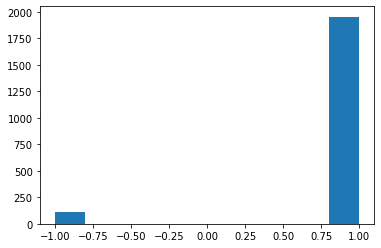

In [115]:
plt.hist(cate)

In [116]:
print(scores[np.where(cate==-1)].max())
print(scores[np.where(cate==-1)].shape[0]/scores.shape[0])


1.0477205819050044
0.0523509452253999


In [117]:
# plt.hist(scores,density=True,bins=100)

In [118]:
# plt.hist(-(scores-scores.max()),density=True,bins=100)

In [119]:
# plt.hist(np.log(scores),density=True,bins=50)

In [120]:
# plt.hist(scores[np.where(scores<50)],density=True,bins=100)

Set a threshold at 3sigma

In [121]:
# lower_limit=scores.mean()-5*scores.std()
lower_limit=5
print(lower_limit)
# lower_limit_2=out.mean()-2*out.std()
# print(lower_limit_2)

5


In [122]:
# print(scores[np.where(scores<lower_limit)].shape[0]/scores.shape[0])
# print(scores[np.where(scores<lower_limit)].shape[0])

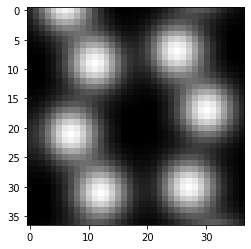

In [123]:
plt.imshow(img_stack_init_flat.reshape(img_stack.shape[0],img_stack_init.shape[1],img_stack_init.shape[2])[np.where(scores<lower_limit)][30,:,:])


In [124]:
# plt.imshow(img_stack_init_flat.reshape(img_stack_init.shape[0],img_stack_init.shape[1],img_stack_init.shape[2])[np.where(scores>3*lower_limit)][20,:,:])


Test patterson function

In [125]:
# arr1=img_stack_flat.reshape(img_stack.shape[0],img_stack.shape[1],img_stack.shape[2])[np.where(scores<lower_limit)][0,:,:]
# arr2=img_stack_flat.reshape(img_stack.shape[0],img_stack.shape[1],img_stack.shape[2])[np.where(scores>10*lower_limit)][20,:,:]

In [126]:
# import scipy
# FFT1=scipy.fft.fft2(arr1)
# patt1=scipy.fft.ifft2(abs(FFT1)**2)
# patterson1=scipy.fft.ifftshift(patt1)
# patt1.shape
# plt.imshow(abs(patterson1))

In [127]:
# import scipy
# FFT2=scipy.fft.fft2(arr2)
# patt2=scipy.fft.ifft2(abs(FFT2)**2)
# patterson2=scipy.fft.ifftshift(patt2)
# patt2.shape
# plt.imshow(abs(patterson2))

In [128]:
# color_outlier=np.zeros((img_stack_flat.shape[0]))
# for i in range(color_outlier.shape[0]):
#   if scores[i]>=lower_limit:
#     color_outlier[i]=1
#   if scores[i]<lower_limit:
#     color_outlier[i]=-1


In [129]:
color_outlier=np.zeros((img_stack_flat.shape[0]))
for i in range(color_outlier.shape[0]):
  if cate[i]==1:
    color_outlier[i]=1
  if cate[i]==-1:
    color_outlier[i]=-1


In [130]:
font = {'family' : 'normal',
        'weight' : 'normal',
        'size'   : 32}

matplotlib.rc('font', **font)

ratio_rank=1

findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


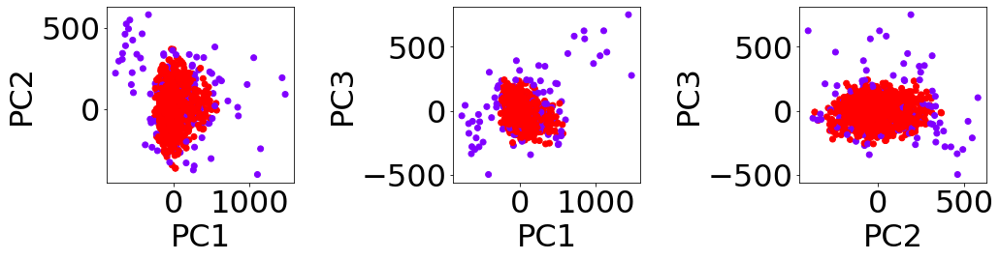

In [131]:
fig, ax = plt.subplots(1, 3, figsize=(15,4.5))
plt.set_cmap('rainbow')


ax[0].scatter(X_vec_t[:,0],X_vec_t[:,1],c=color_outlier)
ax[0].set_xlabel('PC1')
ax[0].set_ylabel('PC2')

ax[1].scatter(X_vec_t[:,0],X_vec_t[:,2],c=color_outlier)
ax[1].set_xlabel('PC1')
ax[1].set_ylabel('PC3')

ax[2].scatter(X_vec_t[:,1],X_vec_t[:,2],c=color_outlier)
ax[2].set_xlabel('PC2')
ax[2].set_ylabel('PC3')

plt.tight_layout(h_pad=2)

ratio_rank=2

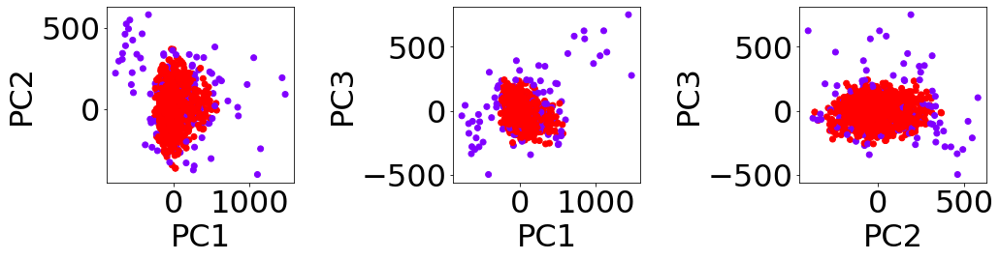

In [132]:
fig, ax = plt.subplots(1, 3, figsize=(15,4.5))
plt.set_cmap('rainbow')


ax[0].scatter(X_vec_t[:,0],X_vec_t[:,1],c=color_outlier)
ax[0].set_xlabel('PC1')
ax[0].set_ylabel('PC2')

ax[1].scatter(X_vec_t[:,0],X_vec_t[:,2],c=color_outlier)
ax[1].set_xlabel('PC1')
ax[1].set_ylabel('PC3')

ax[2].scatter(X_vec_t[:,1],X_vec_t[:,2],c=color_outlier)
ax[2].set_xlabel('PC2')
ax[2].set_ylabel('PC3')

plt.tight_layout(h_pad=2)

rank=3

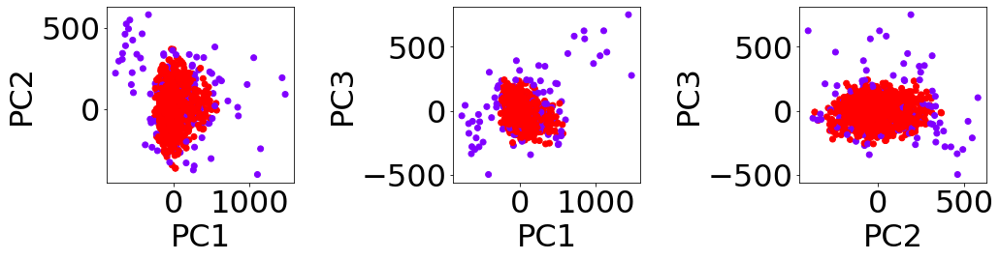

In [133]:
fig, ax = plt.subplots(1, 3, figsize=(15,4.5))
plt.set_cmap('rainbow')


ax[0].scatter(X_vec_t[:,0],X_vec_t[:,1],c=color_outlier)
ax[0].set_xlabel('PC1')
ax[0].set_ylabel('PC2')

ax[1].scatter(X_vec_t[:,0],X_vec_t[:,2],c=color_outlier)
ax[1].set_xlabel('PC1')
ax[1].set_ylabel('PC3')

ax[2].scatter(X_vec_t[:,1],X_vec_t[:,2],c=color_outlier)
ax[2].set_xlabel('PC2')
ax[2].set_ylabel('PC3')

plt.tight_layout(h_pad=2)

rank=4

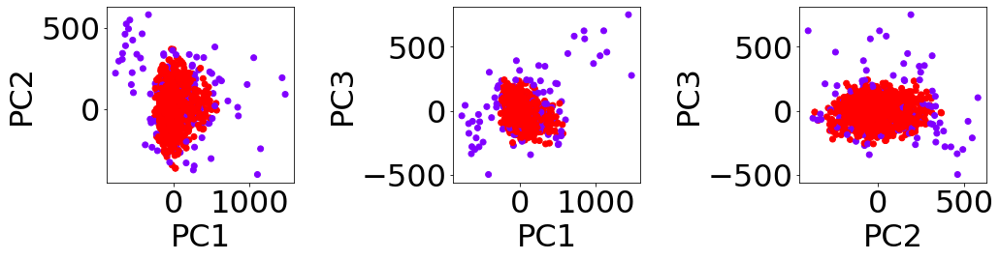

In [134]:
fig, ax = plt.subplots(1, 3, figsize=(15,4.5))
plt.set_cmap('rainbow')


ax[0].scatter(X_vec_t[:,0],X_vec_t[:,1],c=color_outlier)
ax[0].set_xlabel('PC1')
ax[0].set_ylabel('PC2')

ax[1].scatter(X_vec_t[:,0],X_vec_t[:,2],c=color_outlier)
ax[1].set_xlabel('PC1')
ax[1].set_ylabel('PC3')

ax[2].scatter(X_vec_t[:,1],X_vec_t[:,2],c=color_outlier)
ax[2].set_xlabel('PC2')
ax[2].set_ylabel('PC3')

plt.tight_layout(h_pad=2)

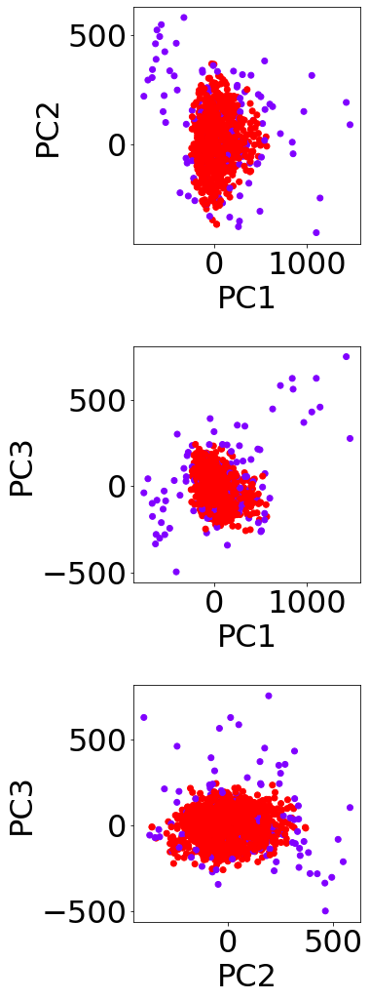

In [135]:
fig, ax = plt.subplots(3, 1, figsize=(6,15))
plt.set_cmap('rainbow')


ax[0].scatter(X_vec_t[:,0],X_vec_t[:,1],c=color_outlier)
ax[0].set_xlabel('PC1')
ax[0].set_ylabel('PC2')

ax[1].scatter(X_vec_t[:,0],X_vec_t[:,2],c=color_outlier)
ax[1].set_xlabel('PC1')
ax[1].set_ylabel('PC3')

ax[2].scatter(X_vec_t[:,1],X_vec_t[:,2],c=color_outlier)
ax[2].set_xlabel('PC2')
ax[2].set_ylabel('PC3')

plt.tight_layout(h_pad=1,w_pad=0)

# Results

(-0.5, 1023.5, 1023.5, -0.5)

<Figure size 432x288 with 0 Axes>

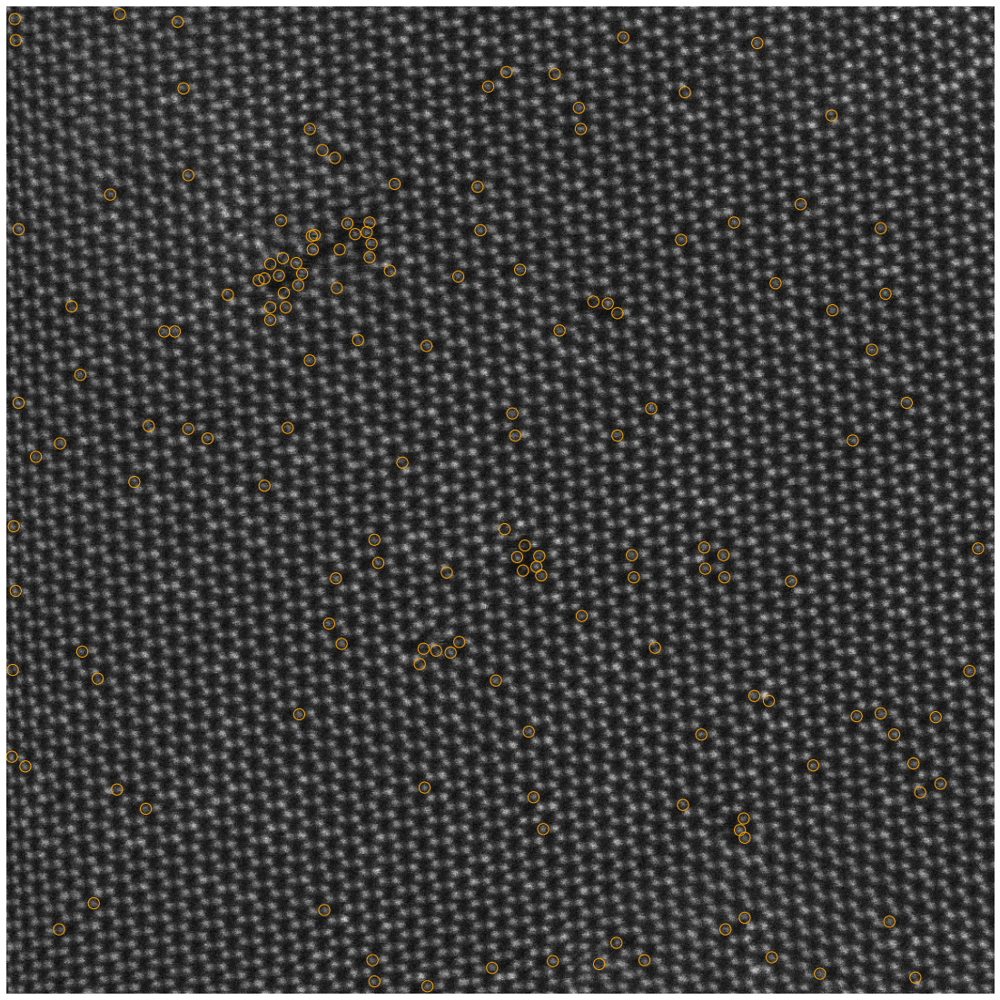

In [136]:
outlier_coord=new_coord_collection[np.where(color_outlier==-1)]
plt.set_cmap('gray')
plt.figure(figsize=(20,20))
# plt.imshow(YG_data_norm)
plt.imshow(data)
# plt.scatter(outlier_coord[:,1],outlier_coord[:,0],s=50,c='r')
plt.scatter(V_positions[:,1],V_positions[:,0],facecolor='None',s=150,edgecolors='orange')

# plt.scatter(xy2[:,1],xy2[:,0],s=15,c='r')
plt.axis('off')

findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


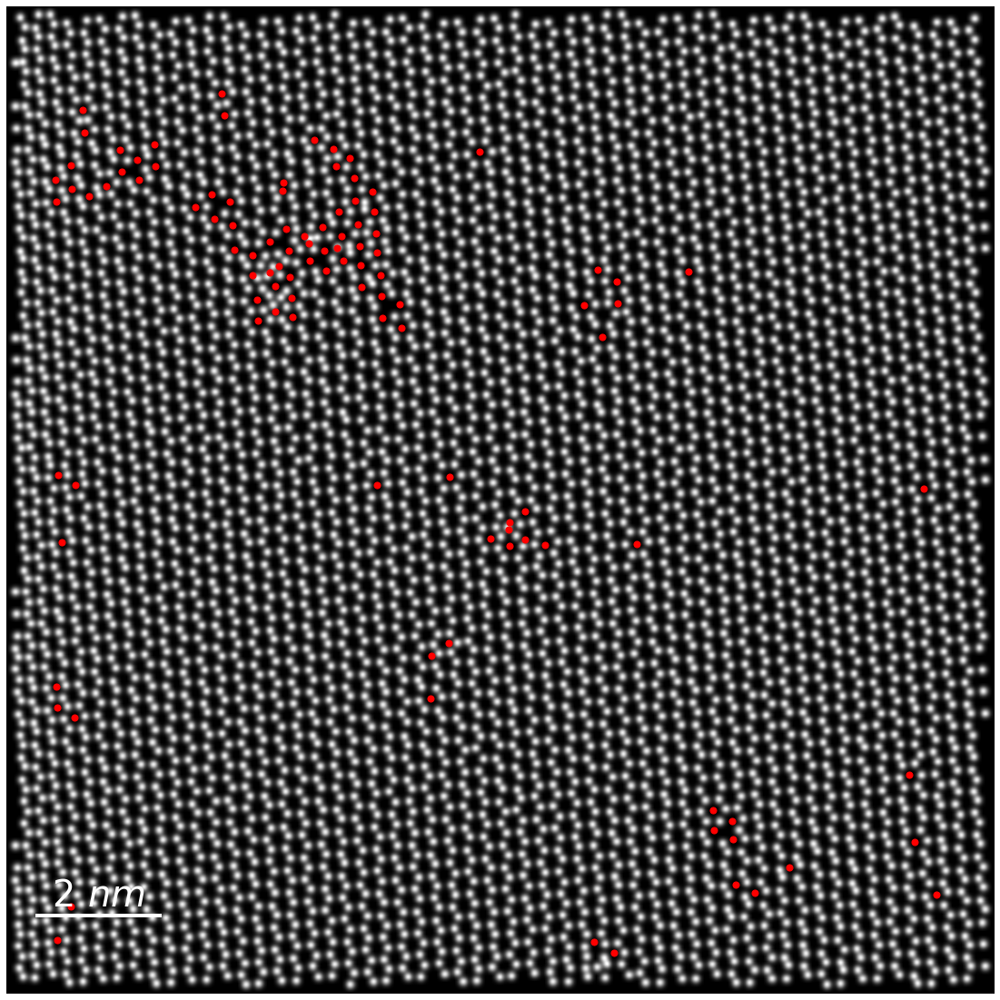

<Figure size 1440x1440 with 0 Axes>

In [137]:
outlier_coord=new_coord_collection[np.where(color_outlier==-1)]


fsx,fsy = 20,20

f,a = plt.subplots(figsize=(fsx,fsy))
gs = gridspec.GridSpec(1, 1, hspace = 0.1, wspace= 0.1)
ax1 = plt.subplot(gs[0, 0])




plt.set_cmap('gray')
plt.figure(figsize=(20,20))
ax1.imshow(semantic_image)
ax1.scatter(outlier_coord[:,1],outlier_coord[:,0],s=50,c='r')
# plt.scatter(xy2[:,1],xy2[:,0],s=15,c='r')
ax1.axis('off')
scalebar1 = patches.Rectangle((0.03*data.shape[1],0.92*data.shape[0]), scalebar, 0.5, linewidth=3,edgecolor='white', facecolor = 'white')
ax1.add_patch(scalebar1);
sbpos = scalebar1.get_bbox().get_points()
sbcenter = (sbpos[1][0]-sbpos[0][0])/2 + sbpos[0][0]  # for whatever reason it doesn't come out quite at the center, hence the 2.3 factor instead of just 2
ax1.text(sbcenter, 0.99*sbpos[1][1], '${}$ $nm$'.format(sb), fontsize = 40, weight = 'bold', color = 'white', ha = 'center')
plt.setp([ax1], xticks = [], yticks = []);

Procedure summarized:
1. patterson function of each subimage (which preserves the bond length and bond angle and makes the features shift-invariant) is processed by PCA
2. Then the PCA weights are input to OneClass SVM for anomaly detection
3. A threshold is set to the scores. Datapoints with scores below the threshold are regarded as defects

Notes from the experience:
1. The quality of sematic image matters. It's not just the positions.
A semantic image with poor resolution gives a different distribtion of PCA weights  
2. The use of patterson function of each image as training sets makes the features shift-invariant and greatly (by x3) reduces the number of PCA components
3. When the shift is too large, refine the xy_refined based on the semantic image should become neccessary